# Metrics

In [1]:
#!pip install pyloudnorm torchmetrics
#!pip install librosa
#!pip install torchmetrics
#!pip install pesq
#!pip install pystoi

In [2]:
import numpy as np
from scipy.linalg import toeplitz #for hifi++ metrics

import torchaudio
import pyloudnorm as pyln
import matplotlib.pyplot as plt

import torch
from torchmetrics.audio import SignalDistortionRatio, ScaleInvariantSignalDistortionRatio
from torchmetrics.audio.pesq import PerceptualEvaluationSpeechQuality #failed to launch but it works!
from torchmetrics.audio.stoi import ShortTimeObjectiveIntelligibility #pesq and stoi

import pesq #for hifi++ metrics

from IPython import display

## SNR, SDR, SI-SDR .....

There are three main scores to evaluate source to noise ratio:

- SNR(Signal-To-Noise Ratio).
\begin{gather*}
    SNR(s, \hat{s}) = 10 \log_{10}{\|s\|^2 \over \|s - \hat{s}\|^2}
\end{gather*}

\begin{gather*}
    SNR(s, s+n) = 10 \log_{10}{\|s\|^2 \over \|n\|^2}
\end{gather*}

- SDR(Signal-To-Distortion Ratio, https://inria.hal.science/inria-00544230/document).
For decomposition
\begin{gather*}
    \hat{s} = s + \varepsilon^{\rm{spat}} + \varepsilon^{\rm{interf}} + \varepsilon^{\rm{artif}}
\end{gather*}
the SDR score looks like
\begin{gather*}
    SDR(\hat{s}, s) = 10 \log_{10}{\|\hat{s}\|^2 \over \|\varepsilon^{\rm{spat}} + \varepsilon^{\rm{artif}}\|^2}
\end{gather*}


- SI-SDR(Scale-Invariant Signal-To-Distortion Ratio, https://browse.arxiv.org/pdf/1811.02508.pdf).
\begin{gather*}
    SI\text{-}SDR(\hat{s}, s) = 10 \log_{10}{\|{\hat{s}^T s \over \|s\|^2}s\|^2 \over \|{\hat{s}^T s \over \|s\|^2}s - \hat{s}\|^2}
\end{gather*}

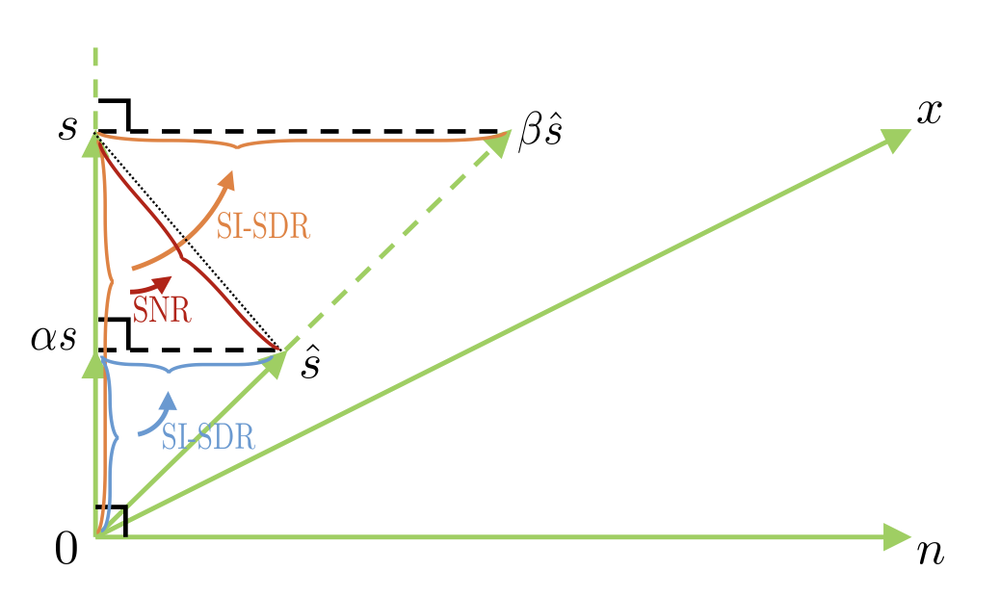

In [30]:
def snr(est, target):
    #??

def si_sdr(est, target):
    #???

In [4]:
target, srTarg = torchaudio.load('./testVoiceTrack.wav')
noise, srNoise = torchaudio.load('./Vacuum2.wav')
print(srTarg,srNoise)
#resample if needed
resampleTransform = torchaudio.transforms.Resample(srNoise, srTarg)
noise = resampleTransform(noise)
noise = noise.numpy().T
target = target.numpy().mean(0,keepdims=True).T #pyln assumes -1 to be channel dim
print(noise.shape,target.shape)

22050 16000
(1135300, 1) (324635, 1)


In [5]:
display.display(display.Audio(noise.T, rate=srTarg))
display.display(display.Audio(target.T, rate=srTarg))

Let's experiment with SNR computed in several cases.

In [7]:
length = min(len(target), len(noise))

target = target[:length]
noise = noise[:length]
s1 = target + noise
#print(s1)
display.display(display.Audio(s1.T, rate=srTarg))#transpose again...

#Compute SNR
snr_val = snr(torch.from_numpy(s1), torch.from_numpy(target))
print(snr_val)

tensor(-8.1279)


In [9]:
s2 = (target + noise) * 0.1
display.display(display.Audio(s2.T, rate=srTarg))

snr_val = snr(torch.from_numpy(s2), torch.from_numpy(target))
print(snr_val)

tensor(0.5512)


So you see how loudness and amplitude can change the metric dramatically. SI-SDR does not have this problem.

In [12]:
sdr = SignalDistortionRatio()

print("SDR for s1:", sdr(torch.from_numpy(s1.squeeze()), torch.from_numpy(target.squeeze())).item())
print("SDR for s2:", sdr(torch.from_numpy(s2.squeeze()), torch.from_numpy(target.squeeze())).item())
print("SI-SDR for s1:", si_sdr(torch.from_numpy(s1), torch.from_numpy(target)))
print("SI-SDR for s2:", si_sdr(torch.from_numpy(s2), torch.from_numpy(target)))
print("SNR for s1:", snr(torch.from_numpy(s1), torch.from_numpy(target)))
print("SNR for s2:", snr(torch.from_numpy(s2), torch.from_numpy(target)))

SDR for s1: -8.375922203063965
SDR for s2: -8.375922203063965
SI-SDR for s1: tensor(-8.4125)
SI-SDR for s2: tensor(-8.4125)
SNR for s1: tensor(-8.1279)
SNR for s2: tensor(0.5512)


In [13]:
nFFT = 1024
windowSize = nFFT
hopSize = 256
window = torch.hann_window(windowSize)
s1 = s1.T
print(s1.shape)

(1, 324635)


In [14]:
def melForward(f):
    return 2595*np.log10(1 + f/700) #wikipedia suggestion
def melInverse(m):
    return (10**(m/2595)-1)*700

C:\Temp\ipykernel_10204\3328093509.py:2: RuntimeWarning: invalid value encountered in log10
  return 2595*np.log10(1 + f/700) #wikipedia suggestion


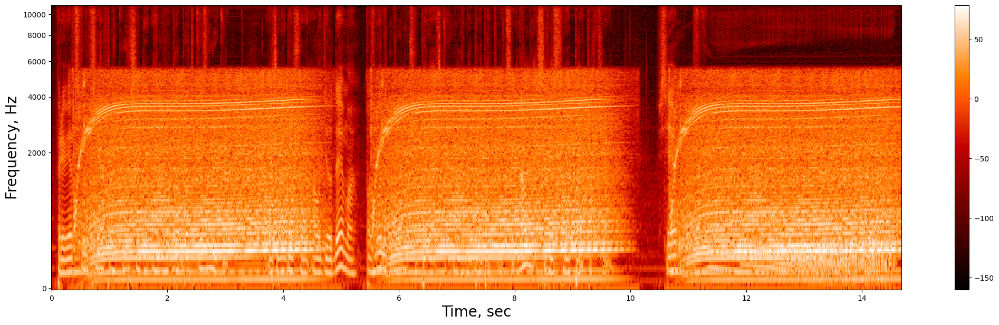

In [16]:
spectrum1 = torch.stft(
    torch.from_numpy(s1),
    n_fft=nFFT,
    hop_length=hopSize,
    win_length=windowSize,
    window=window,
    center=False,
    onesided=True,
    return_complex=False,
)

spectrogram = spectrum1.norm(dim=-1).pow(2)

f,ax = plt.subplots(figsize=(26, 7))

tGrid = np.arange(0,spectrogram.shape[2]*hopSize, hopSize)/srTarg
fGrid = np.arange(0,nFFT/2+0.00001)/(nFFT)*srTarg
tt,ff = np.meshgrid(tGrid,fGrid)

im=ax.pcolormesh(tt,ff,20*torch.log10(spectrogram.squeeze()+1e-8),cmap="gist_heat")
ax.set_xlabel('Time, sec', size=20)
ax.set_ylabel('Frequency, Hz', size=20)
ax.set_yscale("function",functions=(melForward,melInverse))
f.colorbar(im)
plt.show()

In [17]:
display.display(display.Audio(s1, rate=srTarg))#transpose again...

C:\Temp\ipykernel_10204\3328093509.py:2: RuntimeWarning: invalid value encountered in log10
  return 2595*np.log10(1 + f/700) #wikipedia suggestion


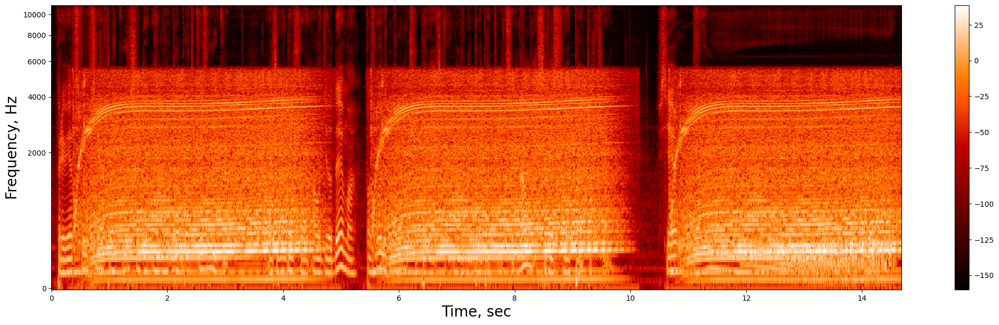

In [18]:
spectrum2 = torch.stft(
    torch.from_numpy((s2.T)),
    n_fft=nFFT,
    hop_length=hopSize,
    win_length=windowSize,
    window=window,
    center=False,
    onesided=True,
    return_complex=False,
)

spectrogram = spectrum2.norm(dim=-1).pow(2)

f,ax = plt.subplots(figsize=(26, 7))

tGrid = np.arange(0,spectrogram.shape[2]*hopSize, hopSize)/srTarg
fGrid = np.arange(0,nFFT/2+0.00001)/(nFFT)*srTarg
tt,ff = np.meshgrid(tGrid,fGrid)

im=ax.pcolormesh(tt,ff,20*torch.log10(spectrogram.squeeze()+1e-8),cmap="gist_heat")
ax.set_xlabel('Time, sec', size=20)
ax.set_ylabel('Frequency, Hz', size=20)
ax.set_yscale("function",functions=(melForward,melInverse))
f.colorbar(im)
plt.show()

In [19]:
display.display(display.Audio(s2.T, rate=srTarg))#transpose again...

### Loudness

It is a different thing than an amplitude, it is measured in decibels, but on a different scale (LUFS). Pyloudnorm provides all necessary equipment for its measurement and normalization.

In [23]:
meter = pyln.Meter(srTarg) # create BS.1770 meter
louds = meter.integrated_loudness(target)
print(louds)
targetNorm = pyln.normalize.loudness(target, louds, -14)#arg,current loudness, target loudness(dB LUFS, not dBFS!)

-22.22444377381785


d:\Programs\Anaconda\envs\studyEnv\lib\site-packages\pyloudnorm\normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


In [24]:
display.display(display.Audio(targetNorm.T, rate=srTarg))#transpose again...

C:\Temp\ipykernel_10204\3328093509.py:2: RuntimeWarning: invalid value encountered in log10
  return 2595*np.log10(1 + f/700) #wikipedia suggestion


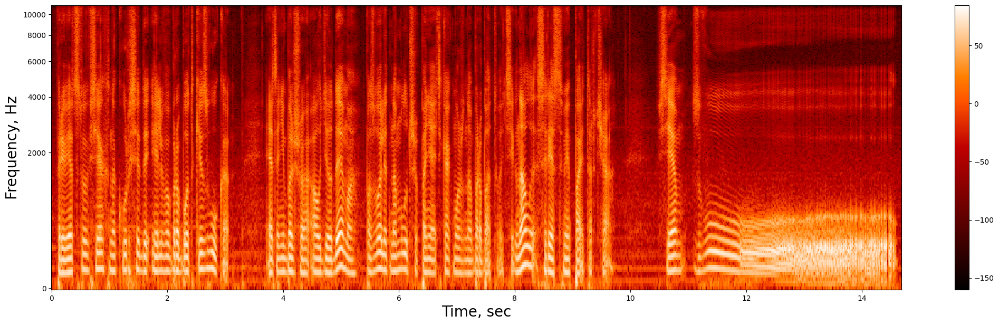

In [25]:
spectrum3 = torch.stft(
    torch.from_numpy((targetNorm.T)),
    n_fft=nFFT,
    hop_length=hopSize,
    win_length=windowSize,
    window=window,
    center=False,
    onesided=True,
    return_complex=False,
)

spectrogram = spectrum3.norm(dim=-1).pow(2)

f,ax = plt.subplots(figsize=(26, 7))

tGrid = np.arange(0,spectrogram.shape[2]*hopSize, hopSize)/srTarg
fGrid = np.arange(0,nFFT/2+0.00001)/(nFFT)*srTarg
tt,ff = np.meshgrid(tGrid,fGrid)

im=ax.pcolormesh(tt,ff,20*torch.log10(spectrogram.squeeze()+1e-8),cmap="gist_heat")
ax.set_xlabel('Time, sec', size=20)
ax.set_ylabel('Frequency, Hz', size=20)
ax.set_yscale("function",functions=(melForward,melInverse))
f.colorbar(im)
plt.show()

## SNR Mixing and Normalization

In [26]:
resample22To16 = torchaudio.transforms.Resample(22050,16000)
target, srTarg = torchaudio.load('./testVoiceTrack.wav')
noise, srNoise = torchaudio.load('./Vacuum2.wav')
print(srTarg,srNoise)

target = target.mean(dim=0,keepdims=True)
noise = noise[:,:min(target.shape[-1],noise.shape[-1])]
target = target[:,:min(target.shape[-1],noise.shape[-1])]
target = target / torch.max(torch.abs(target)) * 0.9 #heuristic peak normalization

targetSignal = resample22To16(target)
noiseSignal = resample22To16(noise)

print(target.shape)


22050 16000
torch.Size([1, 324635])


One of the important things when preparing a dataset of mixes or measuring the hardness of the denoising and/or separation conditions, is signal to noise ratio we already mentioned before. When talking about the mixing, it depicts how much of target signal is presented relative to the noise.

* If $SNR=0$, it means that noise and signal come with equal weighting (just sum).
* If $SNR>0$, it is considered very easy conditions (signal dominates noise)
* If $SNR<0$, it is considered severe conditions (noise dominates signal)

Let's see the example.

In [39]:
def peakNormalize(sig):
    return sig / torch.amax(torch.abs(sig),dim=-1) * 0.9 #heuristic channel-wise peak normalization

def snrMixer(clean, noise, snr):
    """Mixes clean signal and noise in such a way that SNR is equal to the given snr

    Args:
        clean (Tensor): (ch,T) clean signal
        noise (Tensor): (ch,T) noise signal
        snr (float): signal-to-noise ratio

    Returns:
        mix (Tensor): (ch,T) mix
    """    
    # SNR =  20 log10 (norm(clean)/norm(noise))
    # norm(noise) = norm(clean) / 10^{SNR/20}
    ampNoise = torch.linalg.norm(clean) / (10**(snr / 20))
    noiseNorm = (noise / torch.linalg.norm(noise)) * ampNoise
    mix = clean + noiseNorm
    #mix = alpha clean + beta noise
    return mix

In [40]:
mix0 = peakNormalize(snrMixer(targetSignal,noiseSignal,0))
mix5 = peakNormalize(snrMixer(targetSignal,noiseSignal,5))
mixM5 = peakNormalize(snrMixer(targetSignal,noiseSignal,-5))
mix20 = peakNormalize(snrMixer(targetSignal,noiseSignal,20))

In [41]:
noiseSignal.shape

torch.Size([1, 235563])

In [42]:
print(snr(mix0,targetSignal))
print(snr(mix5,targetSignal))
print(snr(mixM5,targetSignal))
print(snr(mix20,targetSignal))

tensor(1.5464)
tensor(4.9883)
tensor(-1.2719)
tensor(19.9140)


In [43]:
display.display(display.Audio(mix0, rate=16000))

In [44]:
display.display(display.Audio(mix5, rate=16000))

In [45]:
display.display(display.Audio(mixM5, rate=16000))

In [46]:
display.display(display.Audio(mix20, rate=16000))

In [47]:
display.display(display.Audio(targetSignal, rate=16000))

In the papers you may find various types of mixing conditions:

* Fixed SNRs: -5,0,5 are the most common
* Random SNRs: chosen randomly on mixing, say, in range $[0,5]$
* Dataset-given

## Automatic Subjective Metrics Survey

These are given by PESQ(2002), STOI(2011), COVL, CSIG and CBAK (2008)...and more.

### PESQ

[Perceptual evaluation of speech quality(2002)](http://www.recursosvoip.com/docs/english/pap465.pdf), ranges form ``-0.5`` (unintelligible) to ``5`` (great quality). It's licensed(!).

Originally it is proposed for telephone communication, it has a very complicated procedure motivated by some spectral studies. Exists in ``pypesq``,``pesq`` and also in ``torchmetrics``.

It requires clean signal for computation.

!! It is important to choose wide-band (WB) for 16kHz and narrow band (NB) for 8kHz, the computations differ.

In [49]:
pesqMetric = PerceptualEvaluationSpeechQuality(16000,"wb")

In [50]:
print(pesqMetric(mix0,targetSignal))#preds,target
display.display(display.Audio(mix0, rate=16000))

tensor(1.0686)


In [51]:
print(pesqMetric(mixM5,targetSignal))#preds,target
display.display(display.Audio(mixM5, rate=16000))

tensor(1.0555)


In [52]:
print(pesqMetric(mix5,targetSignal))#preds,target
display.display(display.Audio(mix5, rate=16000))

tensor(1.0965)


In [53]:
print(pesqMetric(mix20,targetSignal))#preds,target
display.display(display.Audio(mix20, rate=16000))

tensor(2.0019)


In [54]:
print(pesqMetric(targetSignal,targetSignal))#preds,target
display.display(display.Audio(targetSignal, rate=16000))

tensor(4.6439)


### STOI



[Short-Time Objective Intelligibility (2010)](https://ieeexplore.ieee.org/document/5495701) metric measures how well the speech is recognizable, it's in range ``[0,1]``.

In [55]:
pystoiMetric = ShortTimeObjectiveIntelligibility(16000)
print(pystoiMetric(mix0,targetSignal))#preds,target
print(pystoiMetric(mix5,targetSignal))#preds,target
print(pystoiMetric(mixM5,targetSignal))#preds,target
print(pystoiMetric(mix20,targetSignal))#preds,target
print(pystoiMetric(targetSignal,targetSignal))#preds,target

tensor(0.6252)
tensor(0.7202)
tensor(0.5283)
tensor(0.8855)
tensor(1.)


In [56]:
display.display(display.Audio(mix0, rate=16000))
display.display(display.Audio(mix5, rate=16000))
display.display(display.Audio(mixM5, rate=16000))
display.display(display.Audio(mix20, rate=16000))
display.display(display.Audio(targetSignal, rate=16000))

### CBAK, CSIG and COVL

[These(2008)](https://ecs.utdallas.edu/loizou/speech/obj_paper_jan08.pdf) are more modern metrics and are more preferable than PESQ and STOI which are formally outdated but still widely used.

These metrics are in range ``[0,5]`` and measure quality
* of background separation (CBAK)
* of signal intelligibility (CSIG)
* overall of signal (COVL)

The computation includes a certain weighting methodology of other metrics (don't ask us the meaning of these, it's complicated). But if you're interested, see the code below(or scroll it to see the numbers).

In [57]:

# see HiFi++ (Andreev et al 2023)

def composite_eval(ref_wav, deg_wav):
    # returns [sig, bak, ovl]
    alpha = 0.95
    len_ = min(ref_wav.shape[0], deg_wav.shape[0])
    ref_wav = ref_wav[:len_]
    ref_len = ref_wav.shape[0]
    deg_wav = deg_wav[:len_]

    # Compute WSS measure
    wss_dist_vec = wss(ref_wav, deg_wav, 16000)
    wss_dist_vec = sorted(wss_dist_vec, reverse=False)
    wss_dist = np.mean(wss_dist_vec[: int(round(len(wss_dist_vec) * alpha))])

    # Compute LLR measure
    LLR_dist = llr(ref_wav, deg_wav, 16000)
    LLR_dist = sorted(LLR_dist, reverse=False)
    LLRs = LLR_dist
    LLR_len = round(len(LLR_dist) * alpha)
    llr_mean = np.mean(LLRs[:LLR_len])

    # Compute the SSNR
    snr_mean, segsnr_mean = SSNR(ref_wav, deg_wav, 16000)
    segSNR = np.mean(segsnr_mean)

    # Compute the PESQ
    pesq_raw = PESQ(ref_wav, deg_wav)

    def trim_mos(val):
        return min(max(val, 1), 5)

    Csig = 3.093 - 1.029 * llr_mean + 0.603 * pesq_raw - 0.009 * wss_dist
    Csig = trim_mos(Csig)
    Cbak = 1.634 + 0.478 * pesq_raw - 0.007 * wss_dist + 0.063 * segSNR
    Cbak = trim_mos(Cbak)
    Covl = 1.594 + 0.805 * pesq_raw - 0.512 * llr_mean - 0.007 * wss_dist
    Covl = trim_mos(Covl)
    return {"csig": Csig, "cbak": Cbak, "covl": Covl, "pesq": pesq_raw, "ssnr": segSNR}

def SSNR(ref_wav, deg_wav, srate=16000, eps=1e-10):
    """Segmental Signal-to-Noise Ratio Objective Speech Quality Measure
    This function implements the segmental signal-to-noise ratio
    as defined in [1, p. 45] (see Equation 2.12).
    """
    clean_speech = ref_wav
    processed_speech = deg_wav
    clean_length = ref_wav.shape[0]
    processed_length = deg_wav.shape[0]

    # scale both to have same dynamic range. Remove DC too.
    dif = ref_wav - deg_wav
    overall_snr = 10 * np.log10(np.sum(ref_wav**2) / (np.sum(dif**2) + 10e-20))

    # global variables
    winlength = int(np.round(30 * srate / 1000))  # 30 msecs
    skiprate = winlength // 4
    MIN_SNR = -10
    MAX_SNR = 35

    # For each frame, calculate SSNR

    num_frames = int(clean_length / skiprate - (winlength / skiprate))
    start = 0
    time = np.linspace(1, winlength, winlength) / (winlength + 1)
    window = 0.5 * (1 - np.cos(2 * np.pi * time))
    segmental_snr = []

    for frame_count in range(int(num_frames)):
        # (1) get the frames for the test and ref speech.
        # Apply Hanning Window
        clean_frame = clean_speech[start : start + winlength]
        processed_frame = processed_speech[start : start + winlength]
        clean_frame = clean_frame * window
        processed_frame = processed_frame * window

        # (2) Compute Segmental SNR
        signal_energy = np.sum(clean_frame**2)
        noise_energy = np.sum((clean_frame - processed_frame) ** 2)
        segmental_snr.append(10 * np.log10(signal_energy / (noise_energy + eps) + eps))
        segmental_snr[-1] = max(segmental_snr[-1], MIN_SNR)
        segmental_snr[-1] = min(segmental_snr[-1], MAX_SNR)
        start += int(skiprate)
    return overall_snr, segmental_snr

def wss(ref_wav, deg_wav, srate):
    clean_speech = ref_wav
    processed_speech = deg_wav
    clean_length = ref_wav.shape[0]
    processed_length = deg_wav.shape[0]

    assert clean_length == processed_length, clean_length

    winlength = round(30 * srate / 1000.0)  # 240 wlen in samples
    skiprate = np.floor(winlength / 4)
    max_freq = srate / 2
    num_crit = 25  # num of critical bands

    USE_FFT_SPECTRUM = 1
    n_fft = int(2 ** np.ceil(np.log(2 * winlength) / np.log(2)))
    n_fftby2 = int(n_fft / 2)
    Kmax = 20
    Klocmax = 1

    # Critical band filter definitions (Center frequency and BW in Hz)

    cent_freq = [
        50.0,
        120,
        190,
        260,
        330,
        400,
        470,
        540,
        617.372,
        703.378,
        798.717,
        904.128,
        1020.38,
        1148.30,
        1288.72,
        1442.54,
        1610.70,
        1794.16,
        1993.93,
        2211.08,
        2446.71,
        2701.97,
        2978.04,
        3276.17,
        3597.63,
    ]
    bandwidth = [
        70.0,
        70,
        70,
        70,
        70,
        70,
        70,
        77.3724,
        86.0056,
        95.3398,
        105.411,
        116.256,
        127.914,
        140.423,
        153.823,
        168.154,
        183.457,
        199.776,
        217.153,
        235.631,
        255.255,
        276.072,
        298.126,
        321.465,
        346.136,
    ]

    bw_min = bandwidth[0]  # min critical bandwidth

    # set up critical band filters. Note here that Gaussianly shaped filters
    # are used. Also, the sum of the filter weights are equivalent for each
    # critical band filter. Filter less than -30 dB and set to zero.

    min_factor = np.exp(-30.0 / (2 * 2.303))  # -30 dB point of filter

    crit_filter = np.zeros((num_crit, n_fftby2))
    all_f0 = []
    for i in range(num_crit):
        f0 = (cent_freq[i] / max_freq) * (n_fftby2)
        all_f0.append(np.floor(f0))
        bw = (bandwidth[i] / max_freq) * (n_fftby2)
        norm_factor = np.log(bw_min) - np.log(bandwidth[i])
        j = list(range(n_fftby2))
        crit_filter[i, :] = np.exp(-11 * (((j - np.floor(f0)) / bw) ** 2) + norm_factor)
        crit_filter[i, :] = crit_filter[i, :] * (crit_filter[i, :] > min_factor)
    # For each frame of input speech, compute Weighted Spectral Slope Measure

    # num of frames
    num_frames = int(clean_length / skiprate - (winlength / skiprate))
    start = 0  # starting sample
    time = np.linspace(1, winlength, winlength) / (winlength + 1)
    window = 0.5 * (1 - np.cos(2 * np.pi * time))
    distortion = []

    for frame_count in range(num_frames):

        # (1) Get the Frames for the test and reference speeech.
        # Multiply by Hanning window.
        clean_frame = clean_speech[start : start + winlength]
        processed_frame = processed_speech[start : start + winlength]
        clean_frame = clean_frame * window
        processed_frame = processed_frame * window

        # (2) Compuet Power Spectrum of clean and processed

        clean_spec = np.abs(np.fft.fft(clean_frame, n_fft)) ** 2
        processed_spec = np.abs(np.fft.fft(processed_frame, n_fft)) ** 2
        clean_energy = [None] * num_crit
        processed_energy = [None] * num_crit
        # (3) Compute Filterbank output energies (in dB)
        for i in range(num_crit):
            clean_energy[i] = np.sum(clean_spec[:n_fftby2] * crit_filter[i, :])
            processed_energy[i] = np.sum(processed_spec[:n_fftby2] * crit_filter[i, :])
        clean_energy = np.array(clean_energy).reshape(-1, 1)
        eps = np.ones((clean_energy.shape[0], 1)) * 1e-10
        clean_energy = np.concatenate((clean_energy, eps), axis=1)
        clean_energy = 10 * np.log10(np.max(clean_energy, axis=1))
        processed_energy = np.array(processed_energy).reshape(-1, 1)
        processed_energy = np.concatenate((processed_energy, eps), axis=1)
        processed_energy = 10 * np.log10(np.max(processed_energy, axis=1))
        # (4) Compute Spectral Shape (dB[i+1] - dB[i])

        clean_slope = clean_energy[1:num_crit] - clean_energy[: num_crit - 1]
        processed_slope = (
            processed_energy[1:num_crit] - processed_energy[: num_crit - 1]
        )
        # (5) Find the nearest peak locations in the spectra to each
        # critical band. If the slope is negative, we search
        # to the left. If positive, we search to the right.
        clean_loc_peak = []
        processed_loc_peak = []
        for i in range(num_crit - 1):
            if clean_slope[i] > 0:
                # search to the right
                n = i
                while n < num_crit - 1 and clean_slope[n] > 0:
                    n += 1
                clean_loc_peak.append(clean_energy[n - 1])
            else:
                # search to the left
                n = i
                while n >= 0 and clean_slope[n] <= 0:
                    n -= 1
                clean_loc_peak.append(clean_energy[n + 1])
            # find the peaks in the processed speech signal
            if processed_slope[i] > 0:
                n = i
                while n < num_crit - 1 and processed_slope[n] > 0:
                    n += 1
                processed_loc_peak.append(processed_energy[n - 1])
            else:
                n = i
                while n >= 0 and processed_slope[n] <= 0:
                    n -= 1
                processed_loc_peak.append(processed_energy[n + 1])
        # (6) Compuet the WSS Measure for this frame. This includes
        # determination of the weighting functino
        dBMax_clean = max(clean_energy)
        dBMax_processed = max(processed_energy)
        # The weights are calculated by averaging individual
        # weighting factors from the clean and processed frame.
        # These weights W_clean and W_processed should range
        # from 0 to 1 and place more emphasis on spectral
        # peaks and less emphasis on slope differences in spectral
        # valleys.  This procedure is described on page 1280 of
        # Klatt's 1982 ICASSP paper.
        clean_loc_peak = np.array(clean_loc_peak)
        processed_loc_peak = np.array(processed_loc_peak)
        Wmax_clean = Kmax / (Kmax + dBMax_clean - clean_energy[: num_crit - 1])
        Wlocmax_clean = Klocmax / (
            Klocmax + clean_loc_peak - clean_energy[: num_crit - 1]
        )
        W_clean = Wmax_clean * Wlocmax_clean
        Wmax_processed = Kmax / (
            Kmax + dBMax_processed - processed_energy[: num_crit - 1]
        )
        Wlocmax_processed = Klocmax / (
            Klocmax + processed_loc_peak - processed_energy[: num_crit - 1]
        )
        W_processed = Wmax_processed * Wlocmax_processed
        W = (W_clean + W_processed) / 2
        distortion.append(
            np.sum(
                W * (clean_slope[: num_crit - 1] - processed_slope[: num_crit - 1]) ** 2
            )
        )

        # this normalization is not part of Klatt's paper, but helps
        # to normalize the meaasure. Here we scale the measure by the sum of the
        # weights
        distortion[frame_count] = distortion[frame_count] / np.sum(W)
        start += int(skiprate)
    return distortion

def llr(ref_wav, deg_wav, srate):
    clean_speech = ref_wav
    processed_speech = deg_wav
    clean_length = ref_wav.shape[0]
    processed_length = deg_wav.shape[0]

    assert clean_length == processed_length, clean_length

    winlength = round(30 * srate / 1000.0)  # 240 wlen in samples
    skiprate = np.floor(winlength / 4)
    if srate < 10000:
        # LPC analysis order
        P = 10
    else:
        P = 16

    # For each frame of input speech, calculate the Log Likelihood Ratio

    num_frames = int(clean_length / skiprate - (winlength / skiprate))
    start = 0
    time = np.linspace(1, winlength, winlength) / (winlength + 1)
    window = 0.5 * (1 - np.cos(2 * np.pi * time))
    distortion = []

    for frame_count in range(num_frames):

        # (1) Get the Frames for the test and reference speeech.
        # Multiply by Hanning window.
        clean_frame = clean_speech[start : start + winlength]
        processed_frame = processed_speech[start : start + winlength]
        clean_frame = clean_frame * window
        processed_frame = processed_frame * window
        # (2) Get the autocorrelation logs and LPC params used
        # to compute the LLR measure
        R_clean, Ref_clean, A_clean = lpcoeff(clean_frame, P)
        R_processed, Ref_processed, A_processed = lpcoeff(processed_frame, P)
        A_clean = A_clean[None, :]
        A_processed = A_processed[None, :]
        # print('A_clean shape: ', A_clean.shape)
        # print('toe(R_clean) shape: ', toeplitz(R_clean).shape)
        # print('A_clean: ', A_clean)
        # print('A_processed: ', A_processed)
        # print('toe(R_clean): ', toeplitz(R_clean))
        # (3) Compute the LLR measure
        numerator = A_processed.dot(toeplitz(R_clean)).dot(A_processed.T)
        # print('num_1: {}'.format(A_processed.dot(toeplitz(R_clean))))
        # print('num: ', numerator)
        denominator = A_clean.dot(toeplitz(R_clean)).dot(A_clean.T)
        # print('den: ', denominator)
        # log_ = np.log(max(numerator / denominator, 10e-20))
        # print('R_clean: ', R_clean)
        # print('num: ', numerator)
        # print('den: ', denominator)
        # raise NotImplementedError
        log_ = np.log(numerator / denominator)
        # print('np.log({}/{}) = {}'.format(numerator, denominator, log_))
        distortion.append(np.squeeze(log_))
        start += int(skiprate)
    return np.nan_to_num(np.array(distortion))

def lpcoeff(speech_frame, model_order):
    # (1) Compute Autocor lags
    # max?
    winlength = speech_frame.shape[0]
    R = []
    # R = [0] * (model_order + 1)
    for k in range(model_order + 1):
        first = speech_frame[: (winlength - k)]
        second = speech_frame[k:winlength]
        # raise NotImplementedError
        R.append(np.sum(first * second))
        # R[k] = np.sum( first * second)
    # (2) Lev-Durbin
    a = np.ones((model_order,))
    E = np.zeros((model_order + 1,))
    rcoeff = np.zeros((model_order,))
    E[0] = R[0]
    for i in range(model_order):
        # print('-' * 40)
        # print('i: ', i)
        if i == 0:
            sum_term = 0
        else:
            a_past = a[:i]
            # print('R[i:0:-1] = ', R[i:0:-1])
            # print('a_past = ', a_past)
            sum_term = np.sum(a_past * np.array(R[i:0:-1]))
            # print('a_past size: ', a_past.shape)
        # print('sum_term = {:.6f}'.format(sum_term))
        # print('E[i] =  {}'.format(E[i]))
        # print('R[i+1] = ', R[i+1])
        rcoeff[i] = (R[i + 1] - sum_term) / E[i]
        # print('len(a) = ', len(a))
        # print('len(rcoeff) = ', len(rcoeff))
        # print('a[{}]={}'.format(i, a[i]))
        # print('rcoeff[{}]={}'.format(i, rcoeff[i]))
        a[i] = rcoeff[i]
        if i > 0:
            # print('a: ', a)
            # print('a_past: ', a_past)
            # print('a_past[:i] ', a_past[:i])
            # print('a_past[::-1] ', a_past[::-1])
            a[:i] = a_past[:i] - rcoeff[i] * a_past[::-1]
        E[i + 1] = (1 - rcoeff[i] * rcoeff[i]) * E[i]
        # print('E[i+1]= ', E[i+1])
    acorr = np.array(R, dtype=np.float32)
    refcoeff = np.array(rcoeff, dtype=np.float32)
    a = a * -1
    lpparams = np.array([1] + list(a), dtype=np.float32)
    acorr = np.array(acorr, dtype=np.float32)
    refcoeff = np.array(refcoeff, dtype=np.float32)
    lpparams = np.array(lpparams, dtype=np.float32)
    # print('acorr shape: ', acorr.shape)
    # print('refcoeff shape: ', refcoeff.shape)
    # print('lpparams shape: ', lpparams.shape)
    return acorr, refcoeff, lpparams

def PESQ(ref_wav, deg_wav):
    rate = 16000
    try:
        p = pesq(rate, ref_wav, deg_wav, "wb")
    except:
        p = 1
    return p

class CSEMetric:
    # sampling rate is 16000
    def better(self, first, second):
        return first > second

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.func = None
        self.result = dict()

    def _compute(self, samples, real_samples, epoch_num, epoch_info):
        samples /= samples.abs().max(-1, keepdim=True)[0]
        real_samples /= real_samples.abs().max(-1, keepdim=True)[0]
        real_samples = real_samples.squeeze().cpu().numpy()
        samples = samples.squeeze().cpu().numpy()
        if real_samples.ndim == 1:
            real_samples = real_samples[None]
            samples = samples[None]

        res = list()
        for s_real, s_fake in zip(real_samples, samples):
            r = self.func(s_real, s_fake)
            res.append(r)

        self.result["mean"] = np.mean(res)
        self.result["std"] = np.std(res)

class CSIG(CSEMetric):
    # sampling rate is 16000
    name = "CSIG"

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.func = lambda x, y: composite_eval(x, y)["csig"]


class CBAK(CSEMetric):
    # sampling rate is 16000
    name = "CBAK"

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.func = lambda x, y: composite_eval(x, y)["cbak"]


class COVL(CSEMetric):
    # sampling rate is 16000
    name = "COVL"

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.func = lambda x, y: composite_eval(x, y)["covl"]

In [58]:
cbak = CBAK()
csig = CSIG()
covl = COVL()

def getMetric(metric, pred, targ):
    metric._compute(pred,targ,0,0)
    return metric.result["mean"]

In [61]:
metricData = dict()
for sigId,sig in zip(["mix0","mixM5","mix5","mix20","targetSignal"],[mix0,mixM5,mix5,mix20,targetSignal]):
    metricData[sigId] = dict()
    for metricId,metric in zip(["cbak","csig","covl"],[cbak,csig,covl]):
        print(metricId)
        metricData[sigId].update({metricId:getMetric(metric,sig,targetSignal)})


cbak
csig
covl
cbak
csig
covl
cbak
csig
covl
cbak
csig
covl
cbak
csig
covl


In [62]:
for sigId in ["mix0","mixM5","mix5","mix20","targetSignal"]:
    print(sigId + " vs targetSignal")
    for metricId in ["cbak","csig","covl"]:
        print(f"{metricId} : {metricData[sigId][metricId]}")

mix0 vs targetSignal
cbak : 1.8197246090043746
csig : 1.1765162093072035
covl : 1.0441810157387597
mixM5 vs targetSignal
cbak : 1.6017249982739439
csig : 1.0
covl : 1.0
mix5 vs targetSignal
cbak : 2.1525390942237355
csig : 1.6333070907310394
covl : 1.2917616432818024
mix20 vs targetSignal
cbak : 3.022888622894634
csig : 2.850828569836802
covl : 1.9442264958610918
targetSignal vs targetSignal
cbak : 4.317
csig : 3.69599986076355
covl : 2.3989999294281006


In [63]:
display.display(display.Audio(mix0, rate=16000))
display.display(display.Audio(mix5, rate=16000))
display.display(display.Audio(mixM5, rate=16000))
display.display(display.Audio(mix20, rate=16000))
display.display(display.Audio(targetSignal, rate=16000))